<a href="https://colab.research.google.com/github/rameshavinash94/Customer_Segmentation_Clustering/blob/main/Customer_Segmentation_added_assignment_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Customer Segmentation using RFM and Clustering**

**A project of the Olist store Ecommerce Analysis**

**Using RFM Analysis and Clustering techniques like K-Means,AgglomerativeClustering,GMM,BIRCH.etc. to Investigate Customer Segmentation**



**Business Use-Cases In E-commerce Analysis:**

- Product Recommendations for Customers - Recommendation System: Recommendation based on buying patterns/age groups/purchase history, etc.
- Customer churn prediction/identification - Reasons for Customer Churn - loss of a customer due to various reasons.
- Inventory/Procurement/Demand Analysis/Forecasting - Time-Series Analysis: Forecasting the demands based on buying patterns for stock/inventory management
- Fraud Identification - Outlier/ Classification. Filtering or classifying fraudulent transactions 
- Segmenting and Targeting Customer Groups - Clustering. dividing customers into groups for the purpose of targeting advertisements or promotions (based on purchasing patterns, age, purchase history, product categories, etc.)
- Predicting customer purchase/sales/Behavior - Classification. Predicting whether or not a customer will purchase a new product
- Price Forecasting - Regression. Predicting product prices based on price-influencing factors.
- Estimated Delivery Date Prediction. Regression. Predicting the Delivery date of a product based on various factors like zip code, weather, transportation, etc.

**Our Business Problem:**

Customer churn identification - Reasons for Customer getting Churn - loss of a customer due to various reasons.

*Dividing customers into groups(Less Frequency right now but are earlier frequent users of our platform) for the purpose of targeting advertisements or promotions (based on purchasing patterns,purchase history) to get them back to our platform* 

Here we are going to RFM analysis along with clustering techniques to find the golden clusters

**NOTE:** The Data is Highely Skewed So, results won't be perfectly accurate.

#### **IMPORTING LIBRARIES**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import missingno as msno
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import plotly.express as px
from sklearn.mixture import GaussianMixture
from sklearn.cluster import Birch
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import AgglomerativeClustering

#### **LOAD THE DATASETS**

In [ ]:
customers = pd.read_csv('olist_customers_dataset.csv')
order_items = pd.read_csv('olist_order_items_dataset.csv')
order_payment= pd.read_csv('olist_order_payments_dataset.csv')
geolocation = pd.read_csv('olist_geolocation_dataset.csv')
order_reviews = pd.read_csv('olist_order_reviews_dataset.csv')
orders = pd.read_csv('olist_orders_dataset.csv')
products = pd.read_csv('olist_products_dataset.csv')
sellers = pd.read_csv('olist_sellers_dataset.csv')
product_category_name = pd.read_csv('product_category_name_translation.csv')

The ER/Data Modeling Structure of the Datasource
<div>
<img src='https://i.imgur.com/HRhd2Y0.png'>
</div>


*We won't require all the above datasets for our current business usecase for customer segmentation, so selectiong on the necessary files and carryon the EDA and data wrangling on the datasets.*

#### **DATA INTEGRATION AND FEATURE EXTRACTION**

Now Lets merge the required datasets into a single data source for analysis.

In [ ]:
#merge all seller info with all order info
seller_orders=pd.merge(order_items,sellers, how='inner')
df_order = pd.merge(orders, seller_orders, how='inner')
final_order_df = pd.merge(df_order, order_payment,how='inner')

In [ ]:
#merge all products
df_products = pd.merge(product_category_name,products, how='inner')
products_order = pd.merge(final_order_df,df_products)

In [ ]:
#merged the above dataframe with customers to get final dataframe
customer_orders = pd.merge(products_order, customers,how='inner')

In [ ]:
#create new df with final_df as name for understanding
final_df=customer_orders.copy()

In [ ]:
#data shape
final_df.shape

(115878, 34)

In [ ]:
#list of columns
final_df.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value', 'seller_zip_code_prefix', 'seller_city',
       'seller_state', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'product_category_name',
       'product_category_name_english', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state'],
      dtype='object')

In [ ]:
#view the dataframe
final_df

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,...,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1,87285b34884572647811a353c7ac498a,...,268.0,4.0,500.0,19.0,8.0,13.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1,87285b34884572647811a353c7ac498a,...,268.0,4.0,500.0,19.0,8.0,13.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1,87285b34884572647811a353c7ac498a,...,268.0,4.0,500.0,19.0,8.0,13.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP
3,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-15 20:05:16,2017-08-17 15:28:33,2017-08-18 14:44:43,2017-08-28 00:00:00,1,87285b34884572647811a353c7ac498a,...,268.0,4.0,500.0,19.0,8.0,13.0,3a51803cc0d012c3b5dc8b7528cb05f7,3366,sao paulo,SP
4,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,2017-08-02 18:43:15,2017-08-04 17:35:43,2017-08-07 18:30:01,2017-08-15 00:00:00,1,87285b34884572647811a353c7ac498a,...,268.0,4.0,500.0,19.0,8.0,13.0,ef0996a1a279c26e7ecbd737be23d235,2290,sao paulo,SP
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115873,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10 21:21:07,2017-08-10 21:35:26,2017-08-18 16:42:51,2017-08-23 15:36:29,2017-08-31 00:00:00,1,0df37da38a30a713453b03053d60d3f7,...,1105.0,1.0,2800.0,28.0,23.0,23.0,fb9310710003399b031add3e55f34719,3318,sao paulo,SP
115874,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10 21:21:07,2017-08-10 21:35:26,2017-08-18 16:42:51,2017-08-23 15:36:29,2017-08-31 00:00:00,2,0df37da38a30a713453b03053d60d3f7,...,1105.0,1.0,2800.0,28.0,23.0,23.0,fb9310710003399b031add3e55f34719,3318,sao paulo,SP
115875,cfa78b997e329a5295b4ee6972c02979,a2f7428f0cafbc8e59f20e1444b67315,delivered,2017-12-20 09:52:41,2017-12-20 10:09:52,2017-12-20 20:25:25,2018-01-26 15:45:14,2018-01-18 00:00:00,1,3d2c44374ee42b3003a470f3e937a2ea,...,372.0,2.0,300.0,16.0,6.0,12.0,a49e8e11e850592fe685ae3c64b40eca,83870,campo do tenente,PR
115876,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,2017-03-09 09:54:05,2017-03-09 09:54:05,2017-03-10 11:18:03,2017-03-17 15:08:01,2017-03-28 00:00:00,1,ac35486adb7b02598c182c2ff2e05254,...,1517.0,1.0,1175.0,22.0,13.0,18.0,6359f309b166b0196dbf7ad2ac62bb5a,12209,sao jose dos campos,SP


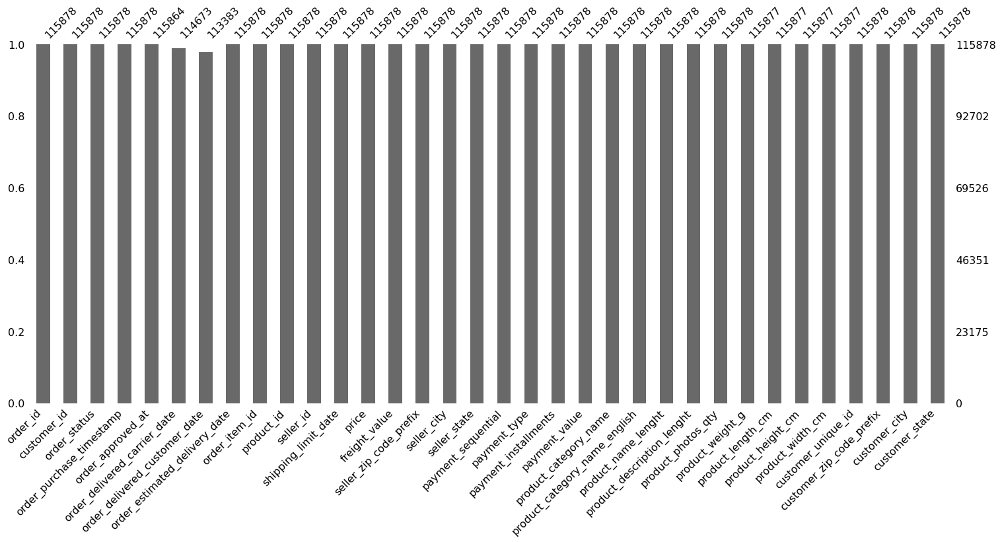

In [ ]:
#plotting data for easier understanding
#missingno is a great library for visualizing missing data.
msno.bar(final_df)

*From the Above, we can't see  much missing values in the required features for our usecase. We are going to extract and filter only the required features and continue further processing*

In [ ]:
# print all the existing status of the orders
final_df['order_status'].unique()

array(['delivered', 'shipped', 'invoiced', 'canceled', 'processing',
       'unavailable', 'approved'], dtype=object)

In [ ]:
#for our analysis we are checking only delivered products
delivered = final_df[final_df['order_status']=='delivered']

In [ ]:
delivered.shape

(113384, 34)

**SIMPLE EDA TO UNDERSTAND THE CUSTOMERS BEHAVIOR ACROSS REGION**

**Since the data is so large, let's start with a state with a high volume of transactions and work our way up. **

In [ ]:
city_wise = final_df.groupby('customer_state')['order_id'].count().to_frame()

In [ ]:
city_wise = city_wise.rename(columns={'order_id':'order_count'}).reset_index()

**Plot orders by state**

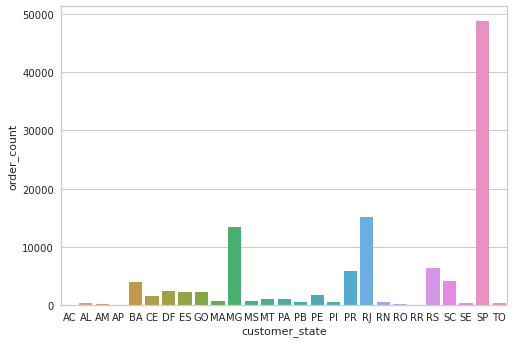

In [ ]:
sns.barplot(x="customer_state", y="order_count", data=city_wise)

**plot customers by state**

In [ ]:
customer_state_cnt=final_df.groupby('customer_state')['customer_id'].nunique()

In [ ]:
customer_state_count = customer_state_cnt.to_frame().rename(columns={'customer_id':'customer_count'}).reset_index()

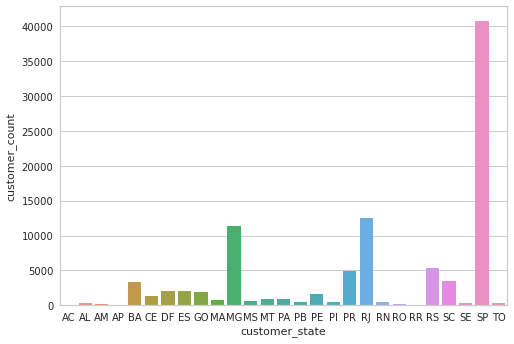

In [ ]:
sns.barplot(x="customer_state", y="customer_count", data=customer_state_count)

We can see from the above that the total number of delivered orders/no.of existing customers are high in SP (Sao Paulo), so for the time being, we will only use that state for analysis because the data for the entire process is very large.

**Since our business problem is Customer Segmentation based on RMF analysis, we are going to use only few features for this usecase. Dropping unnecessary features**

In [ ]:
#filtering only necessary features for the problem statement: customer segmentation 
filtered_df = delivered.drop(columns=['order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date','shipping_limit_date',
       'product_name_lenght','seller_zip_code_prefix','seller_city',
       'seller_state','payment_installments','payment_sequential', 'payment_type','payment_value',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'customer_unique_id','product_category_name'
       ])

In [ ]:
# final list of columns 
filtered_df.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_item_id', 'product_id', 'seller_id', 'price', 'freight_value',
       'product_category_name_english', 'customer_zip_code_prefix',
       'customer_city', 'customer_state'],
      dtype='object')

In [ ]:
#removing duplicates since customer made payment in multiple payment sequence for a single order(credit card,voucher,cash,etc..)
customer_filtered = filtered_df.drop_duplicates()

**Selecting Customers only from Sao Paulo for Analysis**

In [ ]:
#selecting customers from a particular region(SP: São Paulo)
customer_filtered_sp = customer_filtered[customer_filtered['customer_state'] == 'SP']

In [ ]:
customer_filtered_sp.shape

(45810, 13)

In [ ]:
customer_filtered_sp

,order_id,customer_id,order_status,order_purchase_timestamp,order_item_id,product_id,seller_id,price,freight_value,product_category_name_english,customer_zip_code_prefix,customer_city,customer_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,housewares,3149,sao paulo,SP
3,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,7.78,housewares,3366,sao paulo,SP
4,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,7.78,housewares,2290,sao paulo,SP
8,86674ccaee19790309333210917b2c7d,1b338293f35549b5e480b9a3d7bbf3cd,delivered,2018-08-09 11:37:35,1,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,116.90,18.92,perfumery,14500,ituverava,SP
12,df972aca1fba0a417674857678e2c4bb,322eae54daccdcbee96799ebd3a67830,delivered,2018-05-21 11:39:30,1,595fac2a385ac33a80bd5114aec74eb8,ef0ace09169ac090589d85746e3e036f,119.90,15.72,perfumery,6365,carapicuiba,SP
...,...,...,...,...,...,...,...,...,...,...,...,...,...
115870,add4f182072426430ee6c993eab97efe,b87639f5efd3e2316dca5dec5e2f88f4,delivered,2018-01-24 02:23:00,1,e68ede48908dfec1ba4abbcdb86b420f,fa1c13f2614d7b5c4749cbc52fecda94,369.90,10.78,watches_gifts,5175,sao paulo,SP
115872,87b4c933f31145a28413b39d880ad6c3,ddfdf5e9b2659e1fbd073404c9b762e0,delivered,2018-03-02 17:12:05,1,cbaf5898b92064cd5e399c7cff291d0a,06a2c3af7b3aee5d69171b0e14f0ee87,57.99,27.26,health_beauty,2042,sao paulo,SP
115873,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10 21:21:07,1,0df37da38a30a713453b03053d60d3f7,218d46b86c1881d022bce9c68a7d4b15,356.00,18.12,sports_leisure,3318,sao paulo,SP
115874,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10 21:21:07,2,0df37da38a30a713453b03053d60d3f7,218d46b86c1881d022bce9c68a7d4b15,356.00,18.12,sports_leisure,3318,sao paulo,SP


In [ ]:
#finding total value of the order = price + freight_value
customer_filtered_sp.loc[:,'total_order_value']=customer_filtered_sp.loc[:,'price']+customer_filtered_sp.loc[:,'freight_value']

In [ ]:
#drop price and freight value post combining them into a new column
customer_filtered_sp.drop(columns=['price','freight_value'],inplace=True)

#### **SELECTING OBJECTIVE FEATURES : RECENCY, FREQUENCY,MONTERARY VALUE (RFM)**

**According to Wikipedia, RFM stands for the three dimensions:**

_Recency — How recently did the customer purchase?_

_Frequency — How often do they purchase?_

_Monetary Value — How much do they spend?_

*To comprehend the customer's behavior RFM metrics are important because frequency and monetary value influence a customer's lifetime value, and recency influences retention, which is a measure of engagement.
Here, the frequency of customers is calculated by counting each customer's order id; the higher the count, the more frequently the customer purchases from the store.*

**FREQUENCY**

In [ ]:
#lets find the frequency of customer orders
Customer_order_frequency = customer_filtered_sp.groupby('customer_id')['order_id'].count().to_frame()
Customer_order_frequency.rename(columns={'order_id':'Frequency'},inplace=True)

In [ ]:
#finding the customer order frequency
Customer_order_frequency.sort_values('Frequency',ascending=False)

,Frequency
customer_id,
fc3d1daec319d62d49bfb5e1f83123e9,21
be1b70680b9f9694d8c70f41fa3dc92b,20
d5f2b3f597c7ccafbb5cac0bcc3d6024,14
a7693fba2ff9583c78751f2b66ecab9d,14
7d321bd4e8ba1caf74c4c1aabd9ae524,13
...,...
59b142799358cbb79e045d6db8cc1ae1,1
59b2f4f1611eb365ba738a5747caf5a6,1
59b60a9c2357bfbc04dfa8cd38c54a65,1


**RECENCY**

Calculating Recency, here we are calculating recency by subtracting the very recent date with the last transaction date of the customers.

In [ ]:
#sort by order_purchase_timestamp to view the recent purchase made.
customer_filtered.sort_values('order_purchase_timestamp',ascending=False).head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_item_id,product_id,seller_id,price,freight_value,product_category_name_english,customer_zip_code_prefix,customer_city,customer_state
31060,35a972d7f8436f405b56e36add1a7140,898b7fee99c4e42170ab69ba59be0a8b,delivered,2018-08-29 15:00:37,1,d04857e7b4b708ee8b8b9921163edba3,9f505651f4a6abe901a56cdc21508025,84.99,8.76,computers_accessories,13483,limeira,SP
108061,03ef5dedbe7492bdae72eec50764c43f,496630b6740bcca28fce9ba50d8a26ef,delivered,2018-08-29 14:52:00,1,c7f27c5bef2338541c772b5776403e6a,7d7866a99a8656a42c7ff6352a433410,24.90,8.33,party_supplies,9541,sao caetano do sul,SP
47792,168626408cb32af0ffaf76711caae1dc,6e353700bc7bcdf6ebc15d6de16d7002,delivered,2018-08-29 14:18:28,1,bdcf6a834e8faa30dac3886c7a58e92e,2a84855fd20af891be03bc5924d2b453,45.90,15.39,health_beauty,38600,paracatu,MG
63527,0b223d92c27432930dfe407c6aea3041,e60df9449653a95af4549bbfcb18a6eb,delivered,2018-08-29 14:18:23,2,2b4472df15512a2825ae86fd9ae79335,67bf6941ba2f1fa1d02c375766bc3e53,209.00,46.48,kitchen_dining_laundry_garden_furniture,80045,curitiba,PR
63526,0b223d92c27432930dfe407c6aea3041,e60df9449653a95af4549bbfcb18a6eb,delivered,2018-08-29 14:18:23,1,2b4472df15512a2825ae86fd9ae79335,67bf6941ba2f1fa1d02c375766bc3e53,209.00,46.48,kitchen_dining_laundry_garden_furniture,80045,curitiba,PR


*Since, the **last purchase date is '2018-08-29'**, lets consider **current date as the  '2018-08-30'** for the purpose of analysis*

In [ ]:
#convert timestamp to date
customer_filtered['order_purchase_timestamp'] = pd.to_datetime(customer_filtered['order_purchase_timestamp']).dt.date

In [ ]:
#rename column to order_date
customer_filtered.rename(columns={'order_purchase_timestamp':'order_date'},inplace=True)

In [ ]:
#mention current_Date as recent date+1 ('2018-08-30') for the purpose of analysis
current_date=max(customer_filtered['order_date'])+pd.Timedelta(days=1)

#Recent days calculation from order_date
customer_filtered['Recently']=current_date-customer_filtered['order_date']

In [ ]:
customer_filtered

,order_id,customer_id,order_status,order_date,order_item_id,product_id,seller_id,price,freight_value,product_category_name_english,customer_zip_code_prefix,customer_city,customer_state,Recently
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,8.72,housewares,3149,sao paulo,SP,332 days
3,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,7.78,housewares,3366,sao paulo,SP,380 days
4,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,7.78,housewares,2290,sao paulo,SP,393 days
5,bfc39df4f36c3693ff3b63fcbea9e90a,53904ddbea91e1e92b2b3f1d09a7af86,delivered,2017-10-23,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,29.99,14.10,housewares,88032,florianopolis,SC,311 days
6,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24,1,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,118.70,22.76,perfumery,47813,barreiras,BA,37 days
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115873,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10,1,0df37da38a30a713453b03053d60d3f7,218d46b86c1881d022bce9c68a7d4b15,356.00,18.12,sports_leisure,3318,sao paulo,SP,385 days
115874,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10,2,0df37da38a30a713453b03053d60d3f7,218d46b86c1881d022bce9c68a7d4b15,356.00,18.12,sports_leisure,3318,sao paulo,SP,385 days
115875,cfa78b997e329a5295b4ee6972c02979,a2f7428f0cafbc8e59f20e1444b67315,delivered,2017-12-20,1,3d2c44374ee42b3003a470f3e937a2ea,ce248b21cb2adc36282ede306b7660e5,55.90,15.14,musical_instruments,83870,campo do tenente,PR,253 days
115876,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,2017-03-09,1,ac35486adb7b02598c182c2ff2e05254,e24fc9fcd865784fb25705606fe3dfe7,72.00,13.08,health_beauty,12209,sao jose dos campos,SP,539 days


In [ ]:
#create new df for uderstanding
Recently=customer_filtered.copy()

In [ ]:
#group by customers_id nased on the recent order date
Recently=customer_filtered.groupby('customer_id')['Recently'].min().to_frame()
Recently['Recently'] = Recently['Recently'].dt.days.astype('int')

In [ ]:
Recently

,Recently
customer_id,
00012a2ce6f8dcda20d059ce98491703,289
000161a058600d5901f007fab4c27140,410
0001fd6190edaaf884bcaf3d49edf079,548
0002414f95344307404f0ace7a26f1d5,379
000379cdec625522490c315e70c7a9fb,150
...,...
fffcb937e9dd47a13f05ecb8290f4d3e,166
fffecc9f79fd8c764f843e9951b11341,154
fffeda5b6d849fbd39689bb92087f431,100


**MONETARY**

Now, Lets calculate the monetary by summing up all the amounts of the customer.

In [ ]:
#calculate monetary for each customer
Monetary = customer_filtered_sp.groupby('customer_id')['total_order_value'].sum().to_frame()
Monetary.rename(columns={'total_order_value':'MonetaryValue'},inplace=True)

**Now, Lets merge Frequency, Monetary, Recently in a single Dataframe for Customer Segmentation**

In [ ]:
#merging monetary and frequency
Monetary_frequency = pd.merge(Monetary,Customer_order_frequency,how='inner',left_index=True,right_index=True)

In [ ]:
Monetary_frequency

,MonetaryValue,Frequency
customer_id,,
00012a2ce6f8dcda20d059ce98491703,114.74,1
000379cdec625522490c315e70c7a9fb,107.01,1
0004164d20a9e969af783496f3408652,71.80,1
0005aefbb696d34b3424dccd0a0e9fd0,147.33,1
00062b33cb9f6fe976afdcff967ea74d,58.95,1
...,...,...
fff5dd22d522cf28a902185817642a2e,52.78,1
fff93c1da78dafaaa304ff032abc6205,242.49,3
fffa0238b217e18a8adeeda0669923a3,43.72,1


In [ ]:
#finally merge Monetary_frequency with Recently to get RMF for each customer
Customer_RMF= pd.merge(Monetary_frequency,Recently,how='inner',left_index=True,right_index=True)

In [ ]:
Customer_RMF

,MonetaryValue,Frequency,Recently
customer_id,,,
00012a2ce6f8dcda20d059ce98491703,114.74,1,289
000379cdec625522490c315e70c7a9fb,107.01,1,150
0004164d20a9e969af783496f3408652,71.80,1,505
0005aefbb696d34b3424dccd0a0e9fd0,147.33,1,71
00062b33cb9f6fe976afdcff967ea74d,58.95,1,533
...,...,...,...
fff5dd22d522cf28a902185817642a2e,52.78,1,158
fff93c1da78dafaaa304ff032abc6205,242.49,3,78
fffa0238b217e18a8adeeda0669923a3,43.72,1,353


In [ ]:
#describe the df columns
Customer_RMF.describe()

,MonetaryValue,Frequency,Recently
count,39953.000000,39953.000000,39953.000000
mean,142.591791,1.146597,229.263610
std,190.470208,0.556985,151.970639
min,9.590000,1.000000,1.000000
25%,54.950000,1.000000,107.000000
50%,93.570000,1.000000,208.000000
75%,161.720000,1.000000,335.000000
max,6726.660000,21.000000,696.000000


In [ ]:
Customer_RMF.skew(axis = 0, skipna = True)

MonetaryValue    7.338508
Frequency        8.050864
Recently         0.497595
dtype: float64

#### **OUTLIER ANALYSIS POST OBJECTIVE FEATURE EXTRACTIVE**

**Outlier Analysis of Monetary, Frequency and Recency**

Text(0.5, 0, 'Attributes')

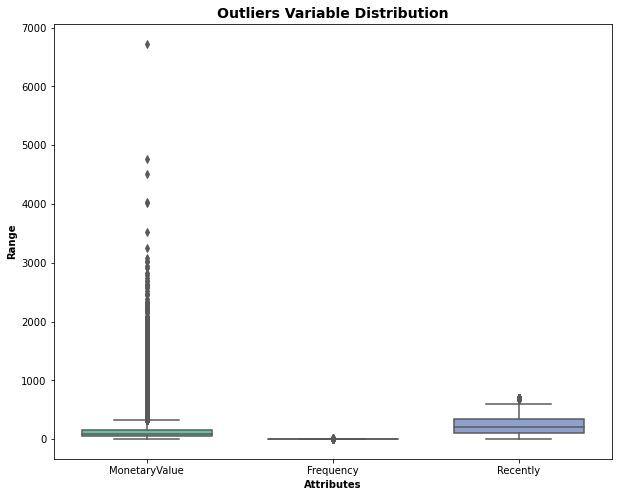

In [ ]:
attributes = ['MonetaryValue','Frequency','Recently']
plt.rcParams['figure.figsize'] = [10,8]
sns.boxplot(data = Customer_RMF[attributes], orient="v", palette="Set2" ,whis=1.5,saturation=1, width=0.7)
plt.title("Outliers Variable Distribution", fontsize = 14, fontweight = 'bold')
plt.ylabel("Range", fontweight = 'bold')
plt.xlabel("Attributes", fontweight = 'bold')

In [ ]:
# Removing (statistical) outliers for MonetaryValue
Q1 = Customer_RMF.MonetaryValue.quantile(0.05)
Q3 = Customer_RMF.MonetaryValue.quantile(0.95)
IQR = Q3 - Q1
Customer_RMF = Customer_RMF[(Customer_RMF.MonetaryValue >= Q1 - 1.5*IQR) & (Customer_RMF.MonetaryValue <= Q3 + 1.5*IQR)]

# Removing (statistical) outliers for Recently
Q1 = Customer_RMF.Recently.quantile(0.05)
Q3 = Customer_RMF.Recently.quantile(0.95)
IQR = Q3 - Q1
Customer_RMF = Customer_RMF[(Customer_RMF.Recently >= Q1 - 1.5*IQR) & (Customer_RMF.Recently <= Q3 + 1.5*IQR)]

Text(0.5, 0, 'Attributes')

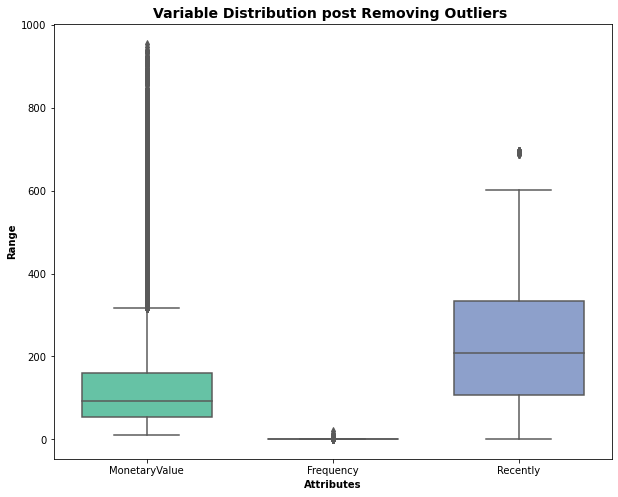

In [ ]:
#plotting post removing outliers
attributes = ['MonetaryValue','Frequency','Recently']
plt.rcParams['figure.figsize'] = [10,8]
sns.boxplot(data = Customer_RMF[attributes], orient="v", palette="Set2" ,whis=1.5,saturation=1, width=0.7)
plt.title("Variable Distribution post Removing Outliers ", fontsize = 14, fontweight = 'bold')
plt.ylabel("Range", fontweight = 'bold')
plt.xlabel("Attributes", fontweight = 'bold')

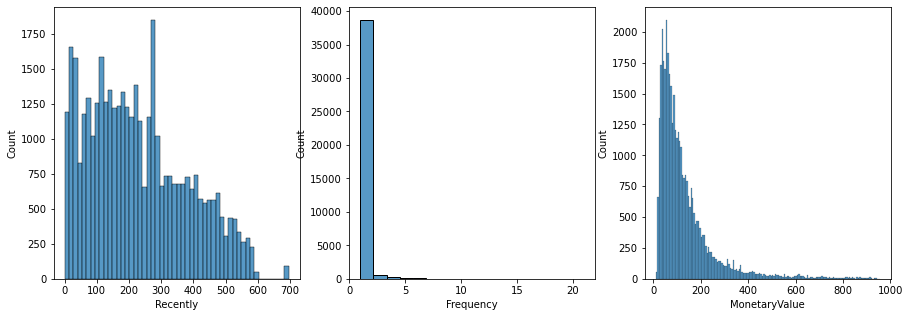

In [ ]:
# Plot RFM distributions
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
# Plot distribution of R
sns.histplot(ax=ax[0],data=Customer_RMF, x="Recently")
sns.histplot(ax=ax[1],data=Customer_RMF, x="Frequency")
# Plot distribution of M
sns.histplot(ax=ax[2],data=Customer_RMF, x="MonetaryValue")

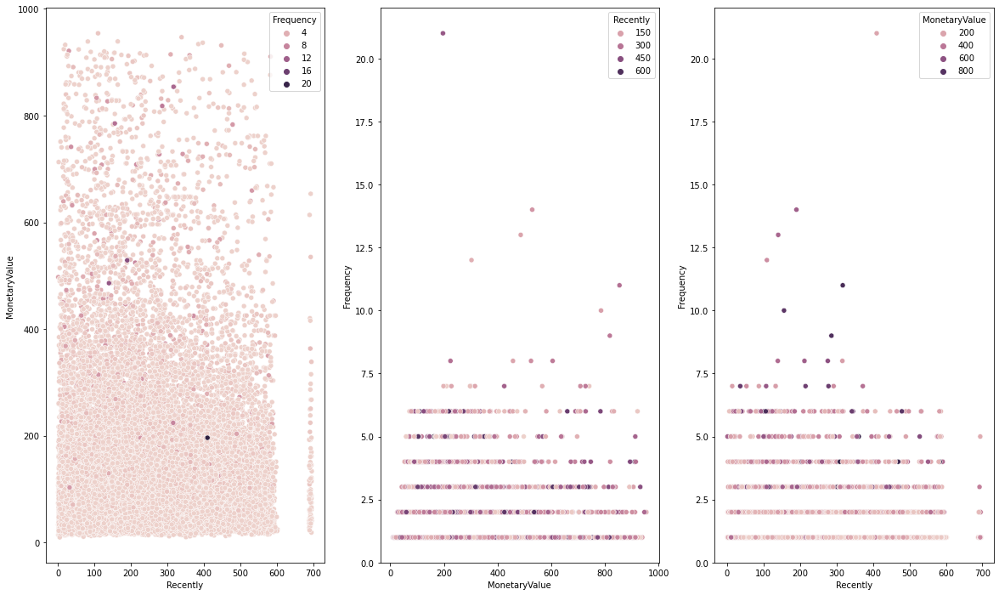

In [ ]:
fig, ax = plt.subplots(1,3)
fig.set_size_inches(20,12)
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='MonetaryValue',data=Customer_RMF,hue="Frequency",ax=ax[0])
#lets plot Frequency vs MonetaryValue to understanding the behavior of the customer
sns.scatterplot(x='MonetaryValue',y='Frequency',data=Customer_RMF,hue="Recently",ax=ax[1])
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='Frequency',data=Customer_RMF,hue="MonetaryValue",ax=ax[2])

**NORMALIZING VALUE PRIOR KMEANS**

In [ ]:
#Now lets standadize the scale
scaler = StandardScaler()
normalized= scaler.fit_transform(Customer_RMF)

In [ ]:
#creating normalized dataframe
Customer_RFM_normalized=pd.DataFrame(normalized)

In [ ]:
#rename columns for understanding
Customer_RFM_normalized.rename(columns={0:'MonetaryValue',1:'Frequency',2:'Recently'},inplace=True)

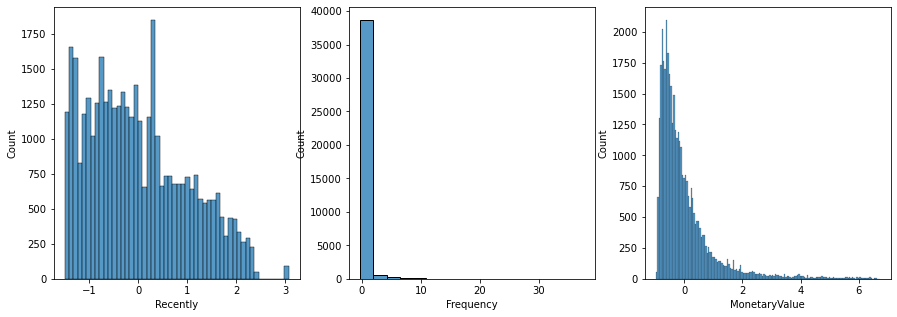

In [ ]:
# Plot RFM distributions
fig, ax = plt.subplots(1, 3, figsize=(15, 5))
# Plot distribution of R
sns.histplot(ax=ax[0],data=Customer_RFM_normalized, x="Recently")
# Plot distribution of F
sns.histplot(ax=ax[1],data=Customer_RFM_normalized, x="Frequency")
# Plot distribution of M
sns.histplot(ax=ax[2],data=Customer_RFM_normalized, x="MonetaryValue")

*From the Above , we can say most of the customers are in the frequency range of 1-5 trasactions in our Store.*

#### **TRYING OUT DIFFERENT CLUSTERING TECHNIQUES**

#### **CLUSTERING ON RMF values of Customer to understand Customer Buying Behavior**

The traditional RFM approach requires you to manually rank customers from 1 to 5 on each of their RFM features. Two ways to define ranks would be to create groups of equal intervals (e.g. range/5), or categorize them based on percentiles (those up to 20th percentile would form a rank).
Since we are ML enthusiasts, why not use an unsupervised learning model to do the job? In fact, our model might perform better than the traditional approach since it groups customers based on their RFM values, instead of their ranking.

##### K-MEANS CLUSTERING

**Now Lets Perform Kmeans on the Above Dataset**

**Finding the optimal value of K using Elbow Method**

In [ ]:
#finding the optimal value of K using elbow method
Distortion=[]
for x in range(1,10):
  kmeans = KMeans(n_clusters=x,max_iter=50)
  kmeans.fit(Customer_RFM_normalized)
  Distortion.append(kmeans.inertia_)

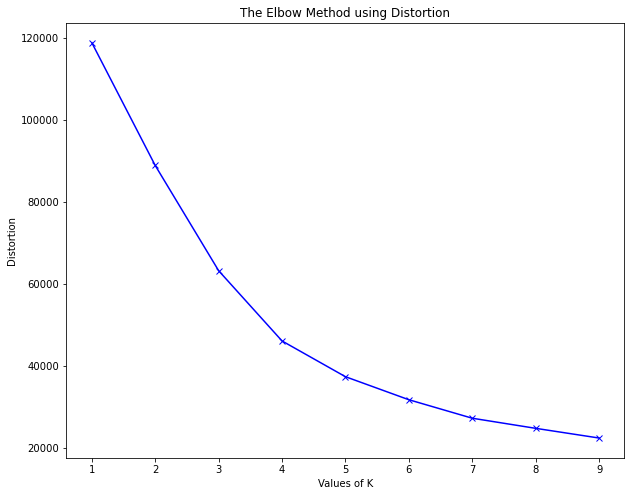

In [ ]:
#plot to view the optimal value of K
K = range(1, 10)
plt.plot(K, Distortion, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()

From the Figure, We can say the optimal value of K is 4 or 5

In [ ]:
#perform Kmeans
kmeans = KMeans(n_clusters=4,max_iter=50)
kmeans.fit(Customer_RFM_normalized)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=50,
       n_clusters=4, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

**Silhouette And Other Metrics**

In [ ]:
print("silhouette_score -", silhouette_score(Customer_RFM_normalized, kmeans.labels_, metric='euclidean'))
print("\n")
print("calinski_harabasz_score -", calinski_harabasz_score(Customer_RFM_normalized, kmeans.labels_))
print("\n")
print("davies_bouldin_score -", davies_bouldin_score(Customer_RFM_normalized, kmeans.labels_))

silhouette_score - 0.4145732905483791


calinski_harabasz_score - 20794.151524317647


davies_bouldin_score - 0.8495853414971863


**3D plot**

In [ ]:
#3d plot post Kmeans
fig = px.scatter_3d(Customer_RFM_normalized, x='MonetaryValue', y='Frequency', z='Recently',
              color=kmeans.labels_)
fig.show()

**Visualizing DATA FOR UNDERSTANDING**

In [ ]:
#append the customer name to the normalized df
Customer_RFM_normalized_kmeans=Customer_RFM_normalized.copy()
Customer_RFM_normalized_kmeans.loc[:,'customer_id'] = Customer_RMF.index

In [ ]:
#add cluster labels to view which customer belong to which cluster group for analysis
Customer_RFM_normalized_kmeans['Cluster_Category'] = kmeans.labels_

In [ ]:
#VIEW THE DATAFRAME
Customer_RFM_normalized_kmeans

,MonetaryValue,Frequency,Recently,customer_id,Cluster_Category
0,-0.122002,-0.269783,0.393397,00012a2ce6f8dcda20d059ce98491703,1
1,-0.184954,-0.269783,-0.521480,000379cdec625522490c315e70c7a9fb,0
2,-0.471698,-0.269783,1.815076,0004164d20a9e969af783496f3408652,1
3,0.143405,-0.269783,-1.041445,0005aefbb696d34b3424dccd0a0e9fd0,0
4,-0.576346,-0.269783,1.999367,00062b33cb9f6fe976afdcff967ea74d,1
...,...,...,...,...,...
39576,-0.626594,-0.269783,-0.468825,fff5dd22d522cf28a902185817642a2e,0
39577,0.918372,3.525586,-0.995372,fff93c1da78dafaaa304ff032abc6205,3
39578,-0.700377,-0.269783,0.814635,fffa0238b217e18a8adeeda0669923a3,1
39579,-0.307926,-0.269783,-0.416170,fffcb937e9dd47a13f05ecb8290f4d3e,0


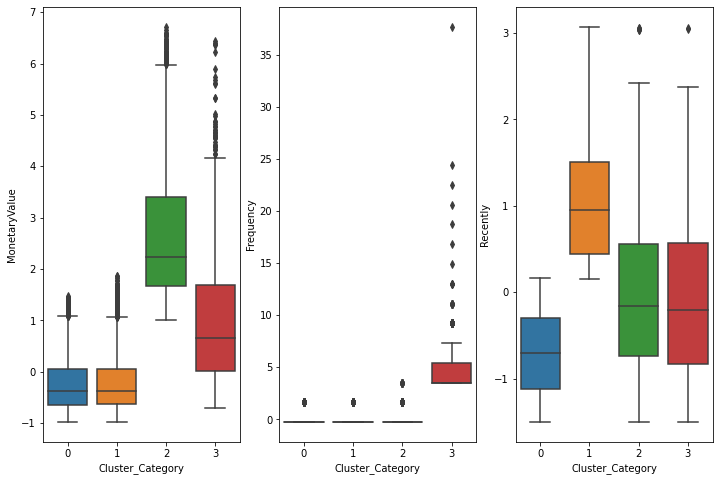

In [ ]:
#plotting box plots of each feature with Cluster Category
fig, ax = plt.subplots(1,3)
fig.set_size_inches(12,8)
#plot based on Cluster_Category and MonetaryValue
sns.boxplot(x='Cluster_Category',y='MonetaryValue',data=Customer_RFM_normalized_kmeans,ax=ax[0])
#plot based on Cluster_Category and Frequency
sns.boxplot(x='Cluster_Category',y='Frequency',data=Customer_RFM_normalized_kmeans,ax=ax[1])
#plot based on Cluster_Category and Recently
sns.boxplot(x='Cluster_Category',y='Recently',data=Customer_RFM_normalized_kmeans,ax=ax[2])

In [ ]:
print("Count of Customers  per each Cluster post Kmeans")
print(Customer_RFM_normalized_kmeans.groupby('Cluster_Category')['customer_id'].count())

Count of Customers  per each Cluster post Kmeans
Cluster_Category
0    21245
1    14548
2     2894
3      894
Name: customer_id, dtype: int64


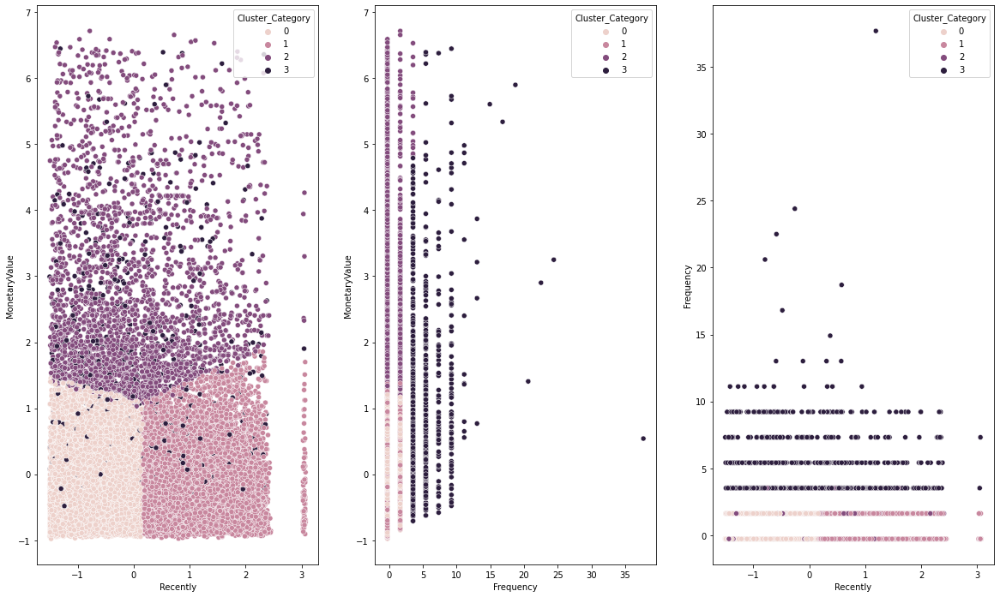

In [ ]:
fig, ax = plt.subplots(1,3)
fig.set_size_inches(20,12)
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='MonetaryValue',data=Customer_RFM_normalized_kmeans,hue="Cluster_Category",ax=ax[0])
#lets plot Frequency vs MonetaryValue to understanding the behavior of the customer
sns.scatterplot(x='Frequency',y='MonetaryValue',data=Customer_RFM_normalized_kmeans,hue="Cluster_Category",ax=ax[1])
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='Frequency',data=Customer_RFM_normalized_kmeans,hue="Cluster_Category",ax=ax[2])

##### **AGGLOMERATIVE CLUSTERING**

In [ ]:
clustering = AgglomerativeClustering(n_clusters=4).fit(Customer_RFM_normalized)

In [ ]:
#append the customer name to the normalized df
Customer_RFM_normalized_agg=Customer_RFM_normalized.copy()
Customer_RFM_normalized_agg.loc[:,'customer_id'] = Customer_RFM_normalized.index
Customer_RFM_normalized_agg['Cluster_Category'] = clustering.labels_

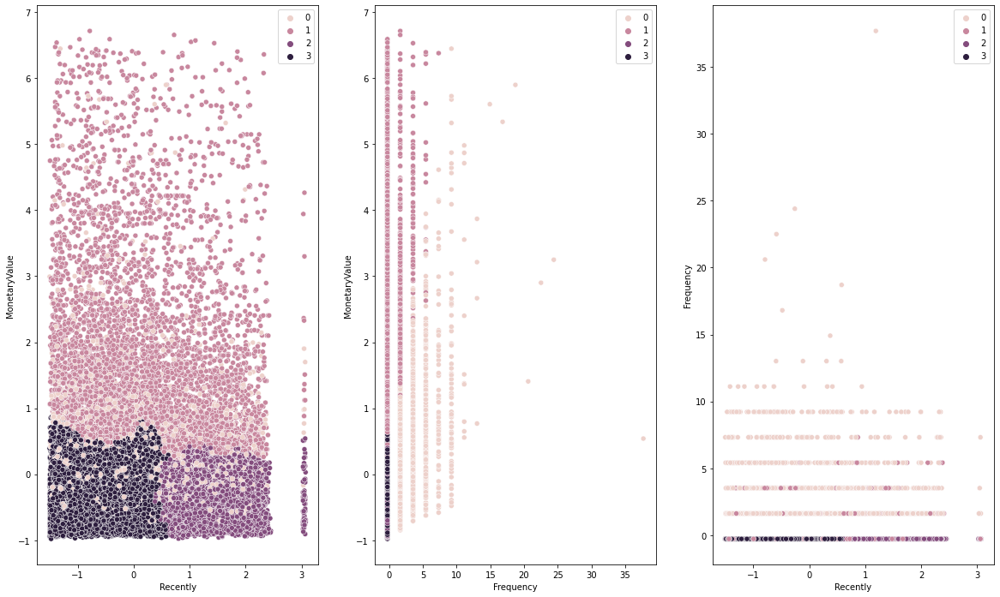

In [ ]:
fig, ax = plt.subplots(1,3)
fig.set_size_inches(20,12)
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='MonetaryValue',data=Customer_RFM_normalized_agg,hue=clustering.labels_,ax=ax[0])
#lets plot Frequency vs MonetaryValue to understanding the behavior of the customer
sns.scatterplot(x='Frequency',y='MonetaryValue',data=Customer_RFM_normalized_agg,hue=clustering.labels_,ax=ax[1])
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='Frequency',data=Customer_RFM_normalized_agg,hue=clustering.labels_,ax=ax[2])

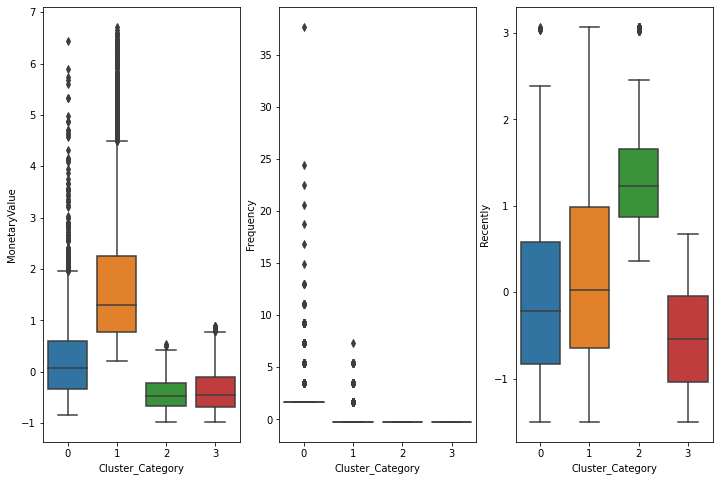

In [ ]:
#plotting box plots of each feature with Cluster Category
fig, ax = plt.subplots(1,3)
fig.set_size_inches(12,8)
#plot based on Cluster_Category and MonetaryValue
sns.boxplot(x='Cluster_Category',y='MonetaryValue',data=Customer_RFM_normalized_agg,ax=ax[0])
#plot based on Cluster_Category and Frequency
sns.boxplot(x='Cluster_Category',y='Frequency',data=Customer_RFM_normalized_agg,ax=ax[1])
#plot based on Cluster_Category and Recently
sns.boxplot(x='Cluster_Category',y='Recently',data=Customer_RFM_normalized_agg,ax=ax[2])

In [ ]:
#3d plot post AgglomerativeClustering
fig = px.scatter_3d(Customer_RFM_normalized_agg, x='MonetaryValue', y='Frequency', z='Recently',
              color=clustering.labels_)
fig.show()

In [ ]:
print("silhouette_score -", silhouette_score(Customer_RFM_normalized, clustering.labels_, metric='euclidean'))
print("\n")
print("calinski_harabasz_score -", calinski_harabasz_score(Customer_RFM_normalized, clustering.labels_))
print("\n")
print("davies_bouldin_score -", davies_bouldin_score(Customer_RFM_normalized, clustering.labels_))

silhouette_score - 0.3967499579412794


calinski_harabasz_score - 16516.06784329128


davies_bouldin_score - 1.0372802433868822


**Limitations  in Kmeans and Hierarchy Clusteirng:**

- An instance of a data can belong to only one Clusteirng
- Overlapping Clusters not possible
- Not a probabilistic model
- Prefer equal sized cluster(especillay Kmeans)


**Gaussian Mixture Clustering**

Components are Gaussian Distribution ( Normal Distribution)

Text(0.5, 1.0, 'BIC and AIC Scores Per Number Of Clusters')

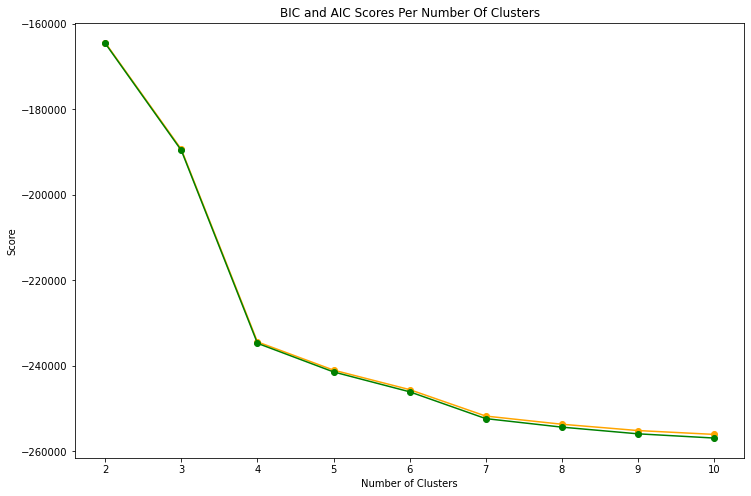

In [ ]:
# Set up a range of cluster numbers to try
n_range = range(2,11)

# Create empty lists to store the BIC and AIC values
bic_score = []
aic_score = []

# Loop through the range and fit a model
for n in n_range:
    gm = GaussianMixture(n_components=n, 
                         random_state=123, 
                         n_init=10)
    gm.fit(Customer_RFM_normalized)
    
    # Append the BIC and AIC to the respective lists
    bic_score.append(gm.bic(Customer_RFM_normalized))
    aic_score.append(gm.aic(Customer_RFM_normalized))
    
# Plot the BIC and AIC values together
fig, ax = plt.subplots(figsize=(12,8),nrows=1)
ax.plot(n_range, bic_score, '-o', color='orange')
ax.plot(n_range, aic_score, '-o', color='green')
ax.set(xlabel='Number of Clusters', ylabel='Score')
ax.set_xticks(n_range)
ax.set_title('BIC and AIC Scores Per Number Of Clusters')

**Peroform Gaussina Mixture on the Actual Data**

**K=4**

In [ ]:
#find the gmm with k=4
gmm = GaussianMixture(n_components=4, random_state=0).fit(Customer_RFM_normalized)
gmm_k4labels = gmm.predict(Customer_RFM_normalized)

In [ ]:
#create gmm dataframe for plotting
Customer_RFM_normalized_gmmk4=Customer_RFM_normalized.copy()
Customer_RFM_normalized_gmmk4['Cluster_Category'] = gmm_k4labels
Customer_RFM_normalized_gmmk4.loc[:,'customer_id'] = Customer_RMF.index

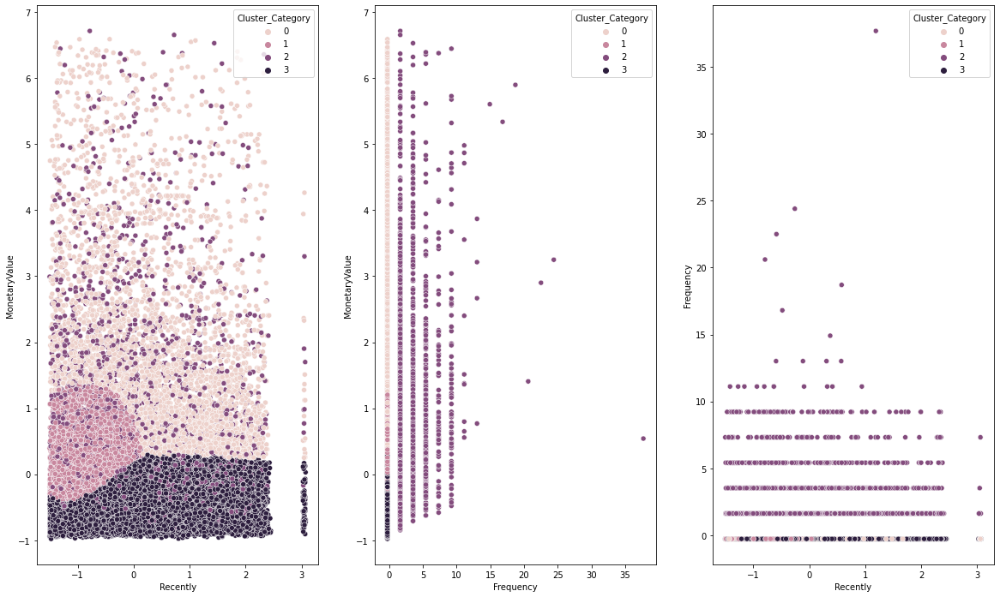

In [ ]:
#plot the data with k=4
fig, ax = plt.subplots(1,3)
fig.set_size_inches(20,12)
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='MonetaryValue',data=Customer_RFM_normalized_gmmk4,hue='Cluster_Category',ax=ax[0])
#lets plot Frequency vs MonetaryValue to understanding the behavior of the customer
sns.scatterplot(x='Frequency',y='MonetaryValue',data=Customer_RFM_normalized_gmmk4,hue='Cluster_Category',ax=ax[1])
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='Frequency',data=Customer_RFM_normalized_gmmk4,hue='Cluster_Category',ax=ax[2])

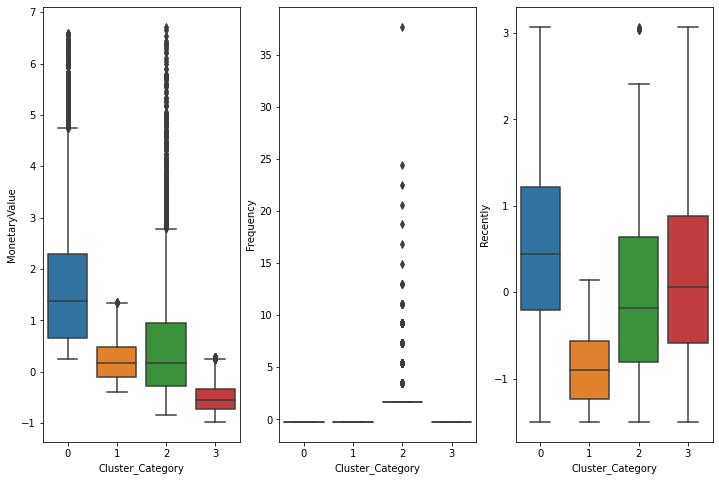

In [ ]:
#plotting box plots of each feature with Cluster Category
fig, ax = plt.subplots(1,3)
fig.set_size_inches(12,8)
#plot based on Cluster_Category and MonetaryValue
sns.boxplot(x='Cluster_Category',y='MonetaryValue',data=Customer_RFM_normalized_gmmk4,ax=ax[0])
#plot based on Cluster_Category and Frequency
sns.boxplot(x='Cluster_Category',y='Frequency',data=Customer_RFM_normalized_gmmk4,ax=ax[1])
#plot based on Cluster_Category and Recently
sns.boxplot(x='Cluster_Category',y='Recently',data=Customer_RFM_normalized_gmmk4,ax=ax[2])

In [ ]:
#group by cluster category(k=4)
print(Customer_RFM_normalized_gmmk4.groupby('Cluster_Category')['customer_id'].count())

Cluster_Category
0     4666
1     7066
2     4011
3    23838
Name: customer_id, dtype: int64


In [ ]:
print("silhouette_score -", silhouette_score(Customer_RFM_normalized, gmm_k4labels, metric='euclidean'))
print("\n")
print("calinski_harabasz_score -", calinski_harabasz_score(Customer_RFM_normalized, gmm_k4labels))
print("\n")
print("davies_bouldin_score -", davies_bouldin_score(Customer_RFM_normalized, gmm_k4labels))

silhouette_score - 0.19207133374799432


calinski_harabasz_score - 11019.210763632058


davies_bouldin_score - 1.1365922494145662


In [ ]:
#3d plot post gmm
fig = px.scatter_3d(Customer_RFM_normalized, x='MonetaryValue', y='Frequency', z='Recently',
              color=gmm_k4labels)
fig.show()

**K=7**

In [ ]:
#find the gmm with k=7
gmm = GaussianMixture(n_components=7, random_state=0).fit(Customer_RFM_normalized)
gmm_k7labels = gmm.predict(Customer_RFM_normalized)

In [ ]:
#create gmm dataframe for plotting (k=7)
Customer_RFM_normalized_gmmk7=Customer_RFM_normalized.copy()
Customer_RFM_normalized_gmmk7['Cluster_Category'] = gmm_k7labels
Customer_RFM_normalized_gmmk7.loc[:,'customer_id'] = Customer_RMF.index

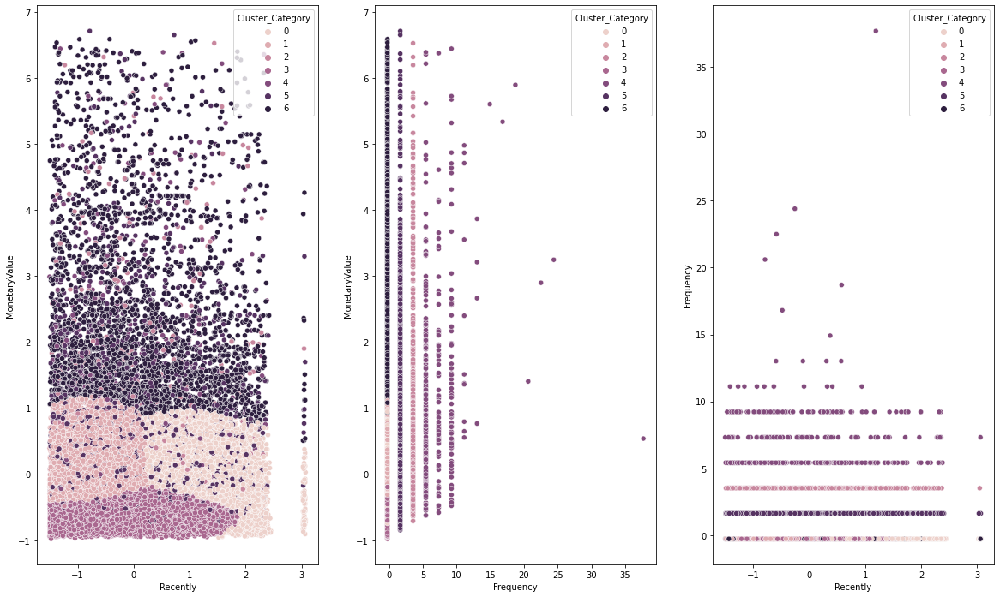

In [ ]:
#plot the data with k=7
fig, ax = plt.subplots(1,3)
fig.set_size_inches(20,12)
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='MonetaryValue',data=Customer_RFM_normalized_gmmk7,hue='Cluster_Category',ax=ax[0])
#lets plot Frequency vs MonetaryValue to understanding the behavior of the customer
sns.scatterplot(x='Frequency',y='MonetaryValue',data=Customer_RFM_normalized_gmmk7,hue='Cluster_Category',ax=ax[1])
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='Frequency',data=Customer_RFM_normalized_gmmk7,hue='Cluster_Category',ax=ax[2])

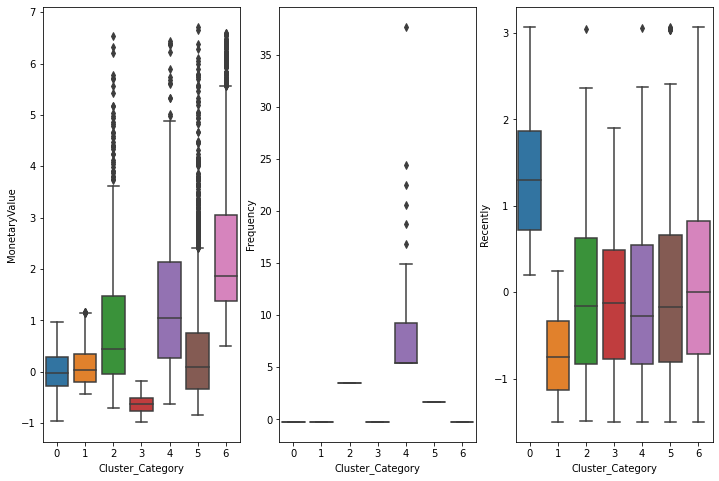

In [ ]:
#plotting box plots of each feature with Cluster Category
fig, ax = plt.subplots(1,3)
fig.set_size_inches(12,8)
#plot based on Cluster_Category and MonetaryValue
sns.boxplot(x='Cluster_Category',y='MonetaryValue',data=Customer_RFM_normalized_gmmk7,ax=ax[0])
#plot based on Cluster_Category and Frequency
sns.boxplot(x='Cluster_Category',y='Frequency',data=Customer_RFM_normalized_gmmk7,ax=ax[1])
#plot based on Cluster_Category and Recently
sns.boxplot(x='Cluster_Category',y='Recently',data=Customer_RFM_normalized_gmmk7,ax=ax[2])

In [ ]:
#group by cluster category(k=7)
print(Customer_RFM_normalized_gmmk7.groupby('Cluster_Category')['customer_id'].count())

Cluster_Category
0     6135
1     9436
2      538
3    16911
4      371
5     3102
6     3088
Name: customer_id, dtype: int64


In [ ]:
print("silhouette_score -", silhouette_score(Customer_RFM_normalized, gmm_k7labels, metric='euclidean'))
print("\n")
print("calinski_harabasz_score -", calinski_harabasz_score(Customer_RFM_normalized, gmm_k7labels))
print("\n")
print("davies_bouldin_score -", davies_bouldin_score(Customer_RFM_normalized, gmm_k7labels))

silhouette_score - 0.19996185961703045


calinski_harabasz_score - 12369.040306611372


davies_bouldin_score - 1.2179535439553892


In [ ]:
#3d plot post gmm
fig = px.scatter_3d(Customer_RFM_normalized, x='MonetaryValue', y='Frequency', z='Recently',
              color=gmm_k7labels)
fig.show()

**BIRCH CLUSTERING**

Balanced Iterative Reducing and Clustering using Hierarchies (BIRCH) is a clustering algorithm that can cluster large datasets by first generating a small and compact summary of the the large dataset that retains as much information as possible. This smaller summary is then clustered instead of clustering the larger dataset.

In [ ]:
clustering = Birch(n_clusters=4).fit_predict(Customer_RFM_normalized)

In [ ]:
Customer_RFM_normalized_birch=Customer_RFM_normalized.copy()
Customer_RFM_normalized_birch['Cluster_Category'] = clustering
Customer_RFM_normalized_birch.loc[:,'customer_id'] = Customer_RMF.index

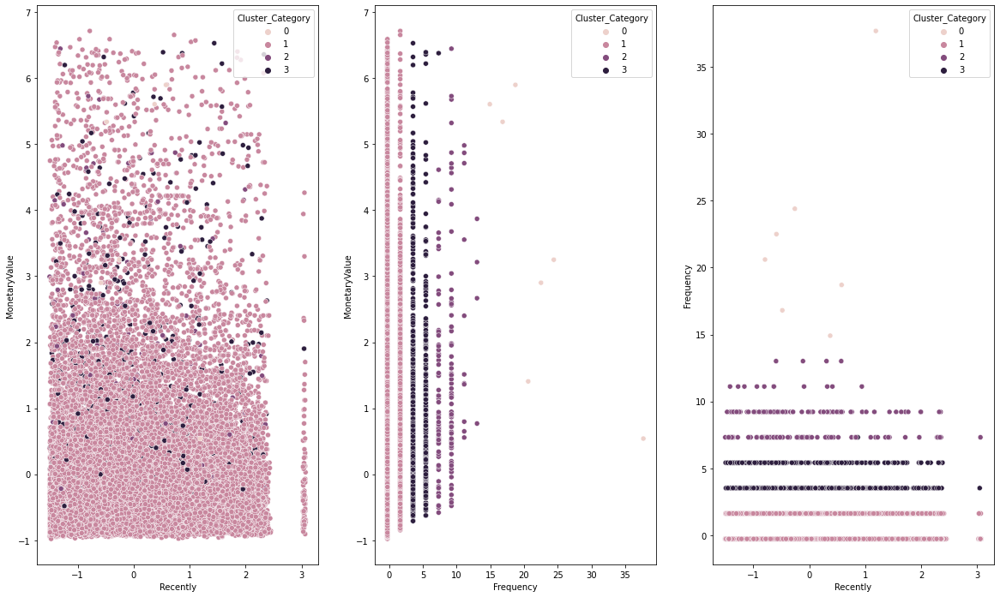

In [ ]:
#plot the data with k=4
fig, ax = plt.subplots(1,3)
fig.set_size_inches(20,12)
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='MonetaryValue',data=Customer_RFM_normalized_birch,hue='Cluster_Category',ax=ax[0])
#lets plot Frequency vs MonetaryValue to understanding the behavior of the customer
sns.scatterplot(x='Frequency',y='MonetaryValue',data=Customer_RFM_normalized_birch,hue='Cluster_Category',ax=ax[1])
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='Frequency',data=Customer_RFM_normalized_birch,hue='Cluster_Category',ax=ax[2])

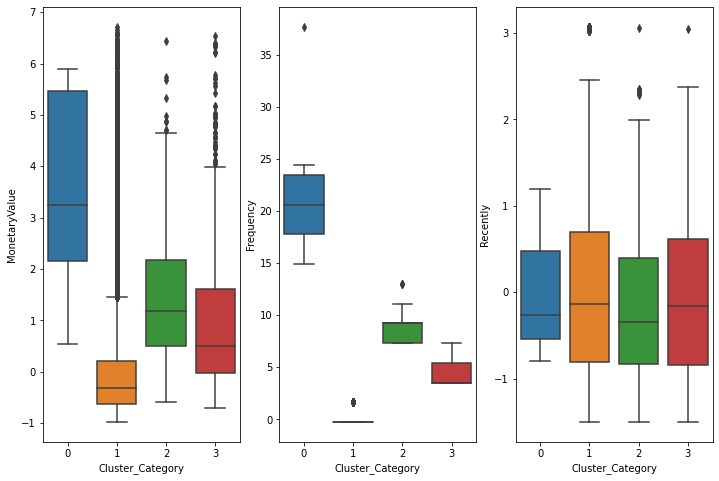

In [ ]:
#plotting box plots of each feature with Cluster Category
fig, ax = plt.subplots(1,3)
fig.set_size_inches(12,8)
#plot based on Cluster_Category and MonetaryValue
sns.boxplot(x='Cluster_Category',y='MonetaryValue',data=Customer_RFM_normalized_birch,ax=ax[0])
#plot based on Cluster_Category and Frequency
sns.boxplot(x='Cluster_Category',y='Frequency',data=Customer_RFM_normalized_birch,ax=ax[1])
#plot based on Cluster_Category and Recently
sns.boxplot(x='Cluster_Category',y='Recently',data=Customer_RFM_normalized_birch,ax=ax[2])

In [ ]:
Customer_RFM_normalized_birch.groupby('Cluster_Category')['customer_id'].count()

Cluster_Category
0        7
1    38672
2      164
3      738
Name: customer_id, dtype: int64

In [ ]:
print("silhouette_score -", silhouette_score(Customer_RFM_normalized, clustering, metric='euclidean'))
print("\n")
print("calinski_harabasz_score -", calinski_harabasz_score(Customer_RFM_normalized, clustering))
print("\n")
print("davies_bouldin_score -", davies_bouldin_score(Customer_RFM_normalized, clustering))

silhouette_score - 0.6171673046275096


calinski_harabasz_score - 4338.682857687129


davies_bouldin_score - 0.7276228101026091


In [ ]:
#3d plot post birch
fig = px.scatter_3d(Customer_RFM_normalized, x='MonetaryValue', y='Frequency', z='Recently',
              color=clustering)
fig.show()

In [ ]:
Customer_RFM_normalized_birch[Customer_RFM_normalized_birch['Cluster_Category'] == 0]

,MonetaryValue,Frequency,Recently,Cluster_Category,customer_id
9286,1.407247,20.604744,-0.791335,0,3b54b5978e9ace64a63f90d176ffb158
19494,2.900988,22.502428,-0.587298,0,7d321bd4e8ba1caf74c4c1aabd9ae524
25987,3.249870,24.400112,-0.258206,0,a7693fba2ff9583c78751f2b66ecab9d
29582,5.897918,18.707059,0.577689,0,be1c4e52bb71e0c54b11a26b8e8d59f2
33327,5.338436,16.809375,-0.481988,0,d6646ea91d8cd9fc7e6882a7068779d4
37961,5.605310,14.911691,0.373651,0,f4d64a735d1f90f13a057ca7f7b5ff87
39053,0.541150,37.683901,1.189800,0,fc3d1daec319d62d49bfb5e1f83123e9


In [ ]:
Customer_RFM_normalized_birch[Customer_RFM_normalized_birch['Cluster_Category'] == 2]

,MonetaryValue,Frequency,Recently,Cluster_Category,customer_id
45,1.172216,9.218638,0.202523,2,00426311a53f3c052943c88b692a3be2
327,0.198376,9.218638,0.946272,2,01ff2b68ecb885ebd063584cbde546e8
370,3.677176,9.218638,-0.541225,2,023fafd700dff9fcc64d28e2defe98b9
544,1.149331,7.320954,-0.225296,2,0355544e5f4818d9553faa520fedf38b
630,0.475104,7.320954,-0.554389,2,03e3a430d50d6e1123627d133c65d5c4
...,...,...,...,...,...
38177,2.103381,7.320954,0.518452,2,f648883563c14819f5e6419f89c6be9e
38241,0.768933,13.014007,0.571107,2,f6af2b95b6be76fe88673d0a62a7db2f
38818,0.540417,9.218638,-0.021259,2,fac377fcf30218090635992d2467f12e
39528,0.602066,7.320954,1.716348,2,ffa5d7160302ea1cc18a275a81930a42


**FRACTAL CLUSTERING FOR FINDING THE GOLDEN CLUSTER**

**OUR PROBLEM STATEMENT IS TO FIND CUSTOMERS WHO ARE ON THE VERGE OF GETTING CHURN AND STEPS TO GET THEM BACK TO OUR PLATFORM**

_SINCE, WE ARE NOT ABLE TO FIND OPTIMAL CLUSTERS USING ABOVE CLUSTERING MECHANISM, ONE BIG REASON IS THE DATA IS HIGHLY SKEWED.
LETS TRY A DIFFERENT APPORACH_

_LETS FIRST CLUSTERING WITH ONLY FREQUENCY, ON TOP OF THAT LETS CLUSTER USING RECENTLY AND FINALLY USING MONETARY TO GET THE OPTIMAL GOLDEN CLUSTER_

In [ ]:
X = Customer_RFM_normalized.iloc[:,1:2]

In [ ]:
Customer_RFM_normalized

,MonetaryValue,Frequency,Recently
0,-0.122002,-0.269783,0.393397
1,-0.184954,-0.269783,-0.521480
2,-0.471698,-0.269783,1.815076
3,0.143405,-0.269783,-1.041445
4,-0.576346,-0.269783,1.999367
...,...,...,...
39576,-0.626594,-0.269783,-0.468825
39577,0.918372,3.525586,-0.995372
39578,-0.700377,-0.269783,0.814635
39579,-0.307926,-0.269783,-0.416170


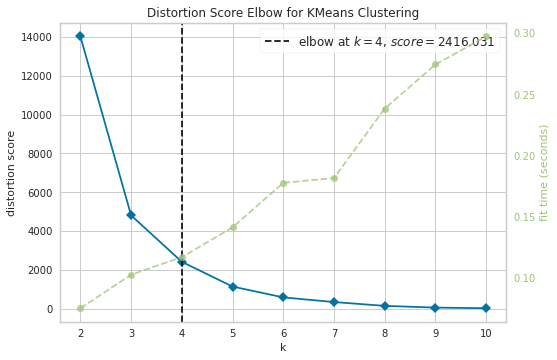

In [ ]:
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,11))
 
visualizer.fit(X)        # Fit the data to the visualizer
visualizer.show()   

In [ ]:
#lets perfrom kmeans
kmeans = KMeans(n_clusters=4,max_iter=50)
kmeans.fit(X)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=50,
       n_clusters=4, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [ ]:
Customer_RFM_normalized_frequency=Customer_RFM_normalized.copy()
Customer_RFM_normalized_frequency['Frequency_Cluster_Category'] = kmeans.labels_
Customer_RFM_normalized_frequency.loc[:,'customer_id'] = Customer_RMF.index

In [ ]:
Customer_RFM_normalized_frequency.groupby('Frequency_Cluster_Category')['customer_id'].count()

Cluster_Category
0    35570
1      737
2     3102
3      172
Name: customer_id, dtype: int64

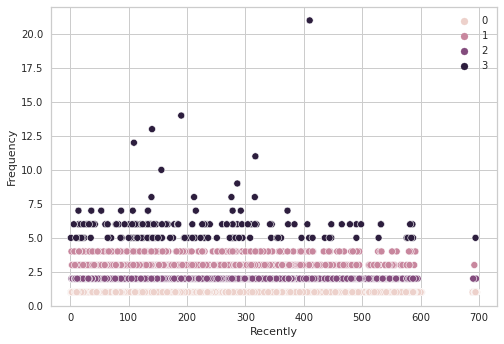

In [ ]:
sns.scatterplot(x='Recently',y='Frequency',data=Customer_RMF,hue=kmeans.labels_)

From, the above, we can say that the golden we should first look at customers who have made huge chuck of transactions with us but stopped recently.

let's filter by clusters 1,3 for now and proceed.

In [ ]:
Golden_Frequency_Cluster = Customer_RFM_normalized_frequency[(Customer_RFM_normalized_frequency['Frequency_Cluster_Category']==1) | (Customer_RFM_normalized_frequency['Frequency_Cluster_Category']==3)]

In [ ]:
Golden_Frequency_Cluster

,MonetaryValue,Frequency,Recently,Cluster_Category,customer_id
45,1.172216,9.218638,0.202523,3,00426311a53f3c052943c88b692a3be2
96,3.751448,3.525586,0.788308,1,009ac0aeacb7e5c368452976385b7903
116,1.926416,3.525586,0.334160,1,00b5072ef1192bc4d02e1d6264317bb0
162,4.380070,3.525586,-0.021259,1,01095519ab759274152540845a1d2004
227,1.518654,3.525586,-0.969045,1,01621ab81b760e6e48e8eb3a300c77bf
...,...,...,...,...,...
39403,0.221586,5.423270,-1.199410,1,febf66a130bc1bc3d35546f466261511
39528,0.602066,7.320954,1.716348,3,ffa5d7160302ea1cc18a275a81930a42
39544,-0.217448,9.218638,-1.298137,3,ffbd58aa41cbab07f08190801e939f59
39571,-0.480249,3.525586,-1.238901,1,fff168ca1f8a1d2e8e2108b231a68a8c


**Now lets do kmeans based on Recency of transactions done from frequency cluster(1,3)**

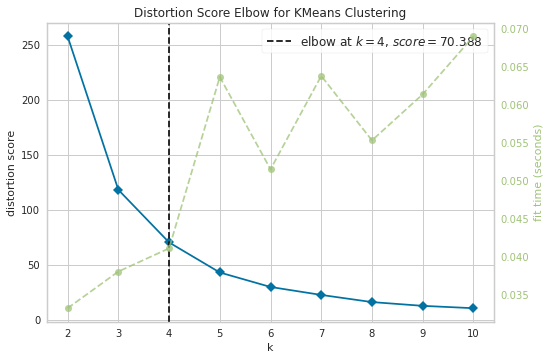

In [ ]:
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,11))
 
X = Golden_Frequency_Cluster.iloc[:,2:3]
visualizer.fit(X)        # Fit the data to the visualizer
visualizer.show()   

In [ ]:
#perform Kmeans(k=4)
kmeans = KMeans(n_clusters=4,max_iter=50)
kmeans.fit(X)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=50,
       n_clusters=4, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [ ]:
#append the recency cluster ids
Golden_Recency_Cluster=Golden_Frequency_Cluster.copy()
Golden_Recency_Cluster['Recency_Cluster_Category'] = kmeans.labels_

In [ ]:
Golden_Recency_Cluster.groupby('Recency_Cluster_Category')['customer_id'].count()

Recency_Cluster_Category
0    270
1    125
2    258
3    256
Name: customer_id, dtype: int64

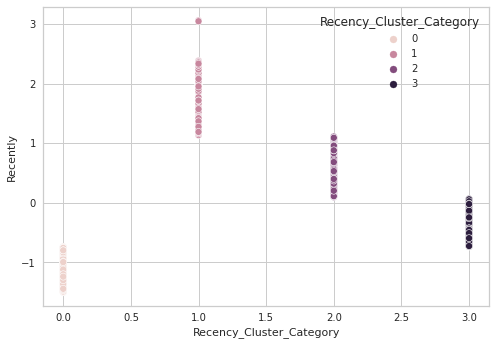

In [ ]:
sns.scatterplot(x='Recency_Cluster_Category',y='Recently',data=Golden_Recency_Cluster,hue='Recency_Cluster_Category')

In [ ]:
Golden_Recency_Cluster[Golden_Recency_Cluster['Recency_Cluster_Category']==3]

**Now lets do kmeans based on Monetary values of transactions done from Recency cluster(1,2) and get the final optimal golden cluster for customer on the verge of getting churn
**

In [ ]:
Golden_Recency_Cluster = Golden_Recency_Cluster[(Golden_Recency_Cluster['Recency_Cluster_Category']==1)| (Golden_Recency_Cluster['Recency_Cluster_Category']==2)]

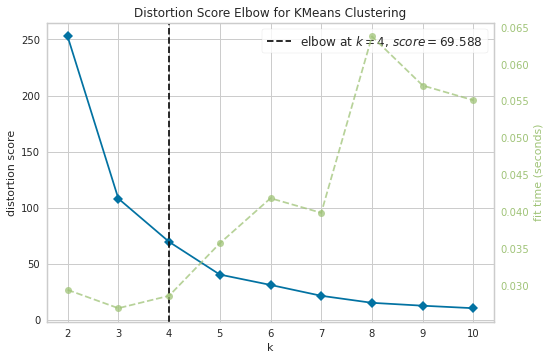

In [ ]:
km = KMeans(random_state=42)
visualizer = KElbowVisualizer(km, k=(2,11))
 
X = Golden_Recency_Cluster.iloc[:,0:1]
visualizer.fit(X)        # Fit the data to the visualizer
visualizer.show()   

In [ ]:
#perform Kmeans(k=4)
kmeans = KMeans(n_clusters=4,max_iter=50)
kmeans.fit(X)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=50,
       n_clusters=4, n_init=10, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [ ]:
#append the monetary cluster ids
Golden_Monetary_Cluster=Golden_Recency_Cluster.copy()
Golden_Monetary_Cluster['Monetary_Cluster_Category'] = kmeans.labels_

In [ ]:
Golden_Monetary_Cluster.groupby('Monetary_Cluster_Category')['customer_id'].count()

Monetary_Cluster_Category
0     57
1    111
2    178
3     37
Name: customer_id, dtype: int64

In [ ]:
Golden_Monetary_Cluster

,MonetaryValue,Frequency,Recently,Cluster_Category,customer_id,Recency_Cluster_Category,Monetary_Cluster_Category
45,1.172216,9.218638,0.202523,3,00426311a53f3c052943c88b692a3be2,2,1
96,3.751448,3.525586,0.788308,1,009ac0aeacb7e5c368452976385b7903,2,0
116,1.926416,3.525586,0.334160,1,00b5072ef1192bc4d02e1d6264317bb0,2,0
327,0.198376,9.218638,0.946272,3,01ff2b68ecb885ebd063584cbde546e8,2,2
382,-0.156206,3.525586,1.380674,1,025868b2a0b2c0cad5e68c7762074892,1,2
...,...,...,...,...,...,...,...
39053,0.541150,37.683901,1.189800,3,fc3d1daec319d62d49bfb5e1f83123e9,1,1
39054,0.735381,3.525586,0.880454,1,fc3e9c3f1e4fce4c1c6e5aa729982c30,2,1
39181,0.400669,3.525586,0.399979,1,fd3348decc9f430e0ac4fe8f6e295b2c,2,2
39183,1.526717,3.525586,2.078349,1,fd36672298845c0b3f7cd97dd2a202c5,1,1


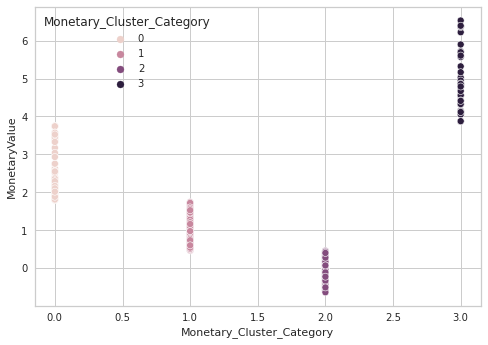

In [ ]:
sns.scatterplot(x='Monetary_Cluster_Category',y='MonetaryValue',data=Golden_Monetary_Cluster,hue='Monetary_Cluster_Category')

**From the above we can classify customers into 4 Categories and take necessary action to avoid churn**

- low spenders (cluster 2)
- average spenders (cluster 1)
- high spenders (cluster 0)
- sky-high spenders (cluster 3)


**We need to understand their purchasing behavior and provide targeted advertisements/product recommendations with coupons to bring them back to their platform**

**low spenders (cluster 2)**

In [ ]:
Customer_RMF.loc[Golden_Monetary_Cluster[Golden_Monetary_Cluster['Monetary_Cluster_Category']==2]['customer_id']]

,MonetaryValue,Frequency,Recently
customer_id,,,
01ff2b68ecb885ebd063584cbde546e8,154.08,6,373
025868b2a0b2c0cad5e68c7762074892,110.54,3,439
059147b644b5fc4e482504191b6be413,74.84,4,457
06ec7aed3161859018db02f695b6600d,98.73,4,346
076a27d502aeeddb25e540fb3caf9b3e,110.73,4,263
077db731d84e53b8b593dd8835f1517b,91.36,4,416
07ae5e78d3f125fb413ccd2e37b7206c,141.84,3,308
0827b8ba0083ce864acc1e1de2428666,143.22,3,311
0af1c58b035366f36dfa7bdde00b27ca,59.31,3,342


**average spenders (cluster 1)**

In [ ]:
Customer_RMF.loc[Golden_Monetary_Cluster[Golden_Monetary_Cluster['Monetary_Cluster_Category']==1]['customer_id']]

,MonetaryValue,Frequency,Recently
customer_id,,,
00426311a53f3c052943c88b692a3be2,273.66,6,260
046219c81738d6ee539ff6c04faa8575,298.79,7,292
0503eb802fe69a16beabc757cdfa27a7,188.38,3,366
082f15c3971915712f89b49d4099326c,201.49,3,266
09b186546a1f76b4b3cb9111dad590ca,237.32,4,364
0d34dca8c8a02afc52be8689c8774af6,310.65,3,273
0e369984255ebae345028d4858c3877c,217.29,3,263
0e772d9e02b17408e716f35cd1dcc222,206.36,4,441
111dd94da5edace3037f01e3c06d81b2,218.25,3,423


**high spenders (cluster 0)**

In [ ]:
Customer_RMF.loc[Golden_Monetary_Cluster[Golden_Monetary_Cluster['Monetary_Cluster_Category']==0]['customer_id']]

,MonetaryValue,Frequency,Recently
customer_id,,,
009ac0aeacb7e5c368452976385b7903,590.37,3,349
00b5072ef1192bc4d02e1d6264317bb0,366.27,3,280
06323ee39c5605bd9e243f9aacdcbae7,589.00,4,317
0c4aa71dee29939b7e8c95cf38265ab8,397.02,3,302
18af14116834f457513ba68d3c208eda,566.00,4,415
1ec77d6842fe27fbd38a9341f7e3a666,379.47,3,380
2ed1b5c01561bcf39cc2f1566a8ac9f1,452.72,4,591
2ed8567c7952b9d78d2cda0a0679dd6f,372.84,6,294
2fbffc4b0be525d79262bcd945b22f10,357.90,3,269


**sky-high spenders (cluster 3)**

In [ ]:
Customer_RMF.loc[Golden_Monetary_Cluster[Golden_Monetary_Cluster['Monetary_Cluster_Category']==3]['customer_id']]

,MonetaryValue,Frequency,Recently
customer_id,,,
0445283ab2d69419d518a3b1d82092c7,688.04,4,255
06c2c1e92714f3fe285f962909a59c15,690.00,6,345
23fd1057f419241e5e9307e2ce4b0b28,639.90,5,528
2945f7826483e9c7360613af4d7e6426,631.41,3,428
2baf69aa9f7c51867a17a6bb88fb194e,689.52,3,283
3a9c4e44b0cfe2c46d1aaa0a035aa6fb,741.75,3,526
3cf1e152f5f67aaca5dd7c13e375713d,893.52,4,469
421d65b7d24e669c0d728b6ad9c0742c,831.72,3,283
4724ab68cedd37b02cd6ef4489dab3a4,746.96,4,408


**Now, that we have 4 golden clusters of customers who are getting churn or alomost churn. we can further perform analysis on top of these customers to understand their buying behavior and provide offers/recommendations based on the buying pattern to attrast interest back to our platform**